# <center> REINFORCEMENT LEARNING GROUP PROJECT 
# <center> HIDE AND SEEK - TWO AGENTS IMPLEMENTATION

## <center> Authors: Paul BEDIER, Lucrezia CERTO, Pieter Jan MOTMANS
## <center> MSc Data Sciences & Business Analytics, CentraleSupélec

### <center> Github: https://github.com/motmans-pj/HideAndSeek

### IMPORTS

In [1]:
# Install required libraries
! pip install pettingzoo
! pip install pygame
! pip install gymnasium

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 816.1/816.1 kB 21.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 925.5/925.5 kB 34.0 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
# PyGame Display
import os
os.environ['SDL_VIDEODRIVER']='dummy'
import pygame
pygame.display.set_mode((640,480))

pygame 2.3.0 (SDL 2.24.2, Python 3.9.16)
Hello from the pygame community. https://www.pygame.org/contribute.html


<Surface(640x480x32 SW)>

In [3]:
# Cloning our Github with environment and agent implementations
repo_url = "https://github.com/motmans-pj/HideAndSeek.git"
! git clone $repo_url
%cd /content/HideAndSeek

Cloning into 'HideAndSeek'...
remote: Enumerating objects: 101, done.
remote: Counting objects: 100% (101/101), done.
remote: Compressing objects: 100% (81/81), done.
remote: Total 101 (delta 43), reused 48 (delta 16), pack-reused 0
Receiving objects: 100% (101/101), 365.39 KiB | 19.23 MiB/s, done.
Resolving deltas: 100% (43/43), done.
/content/HideAndSeek


In [4]:
# Import libraries
from pettingzoo.utils.env import ParallelEnv
import functools
import random
import pygame
from copy import copy
import numpy as np
import gymnasium as gym
from pettingzoo.test import parallel_api_test
from collections import defaultdict
from matplotlib import pyplot as plt

In [5]:
# Import github modules
from environment import *

from agents.agent import *
from agents.Expected_Sarsa_Agent import *
from agents.QLearning_Agent import *
from agents.Episodic_Sarsa_Agent import *

from utilities.train_test_TabularMethods import *
from utilities.train_test_EpisodicMethod import *
from utilities.plotting import *


# TESTING

## BEFORE AGENT IMPLEMENTATION - RANDOM ACTIONS

### Rendering: Static case
Playing the static game with a QLearning agent: no line of sight, agent has to 
go on top of hider. 

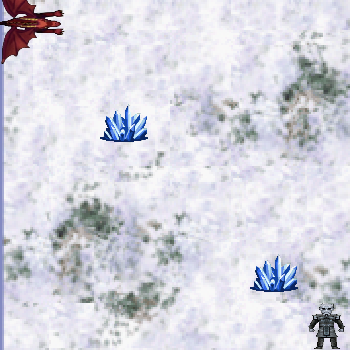

{'Seeker': 0, 'Hider': 2}



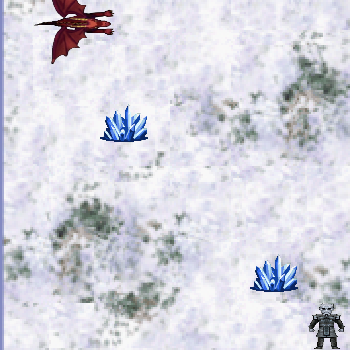

{'Seeker': 2, 'Hider': 3}



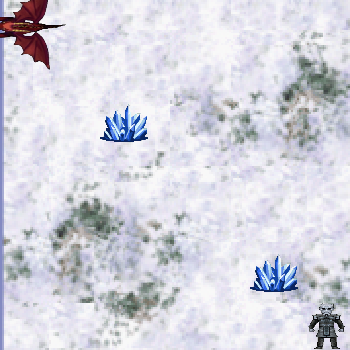

{'Seeker': 1, 'Hider': 3}



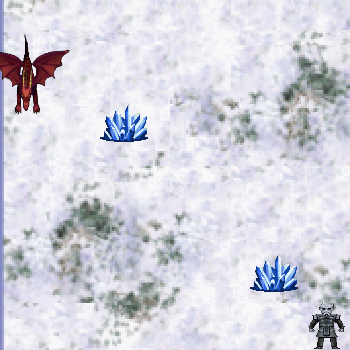

{'Seeker': 3, 'Hider': 2}



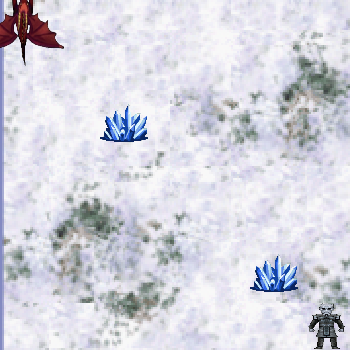

{'Seeker': 1, 'Hider': 2}



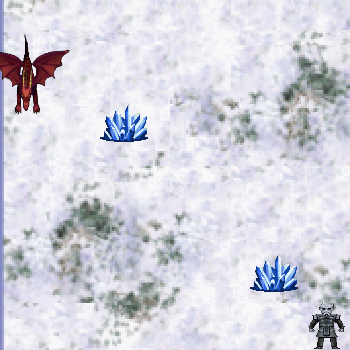

{'Seeker': 3, 'Hider': 2}



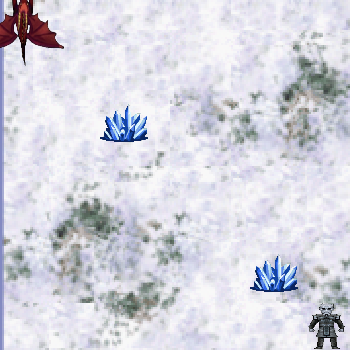

{'Seeker': 1, 'Hider': 2}



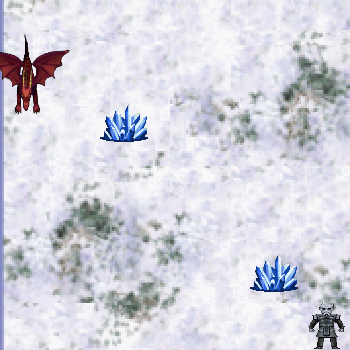

{'Seeker': 3, 'Hider': 2}



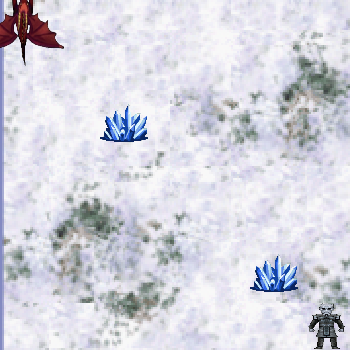

{'Seeker': 0, 'Hider': 3}



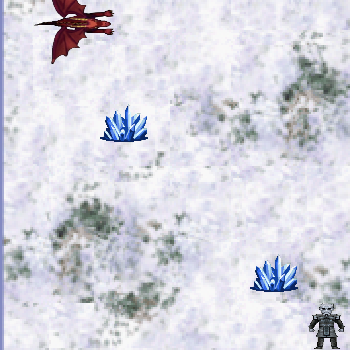

{'Seeker': 0, 'Hider': 2}



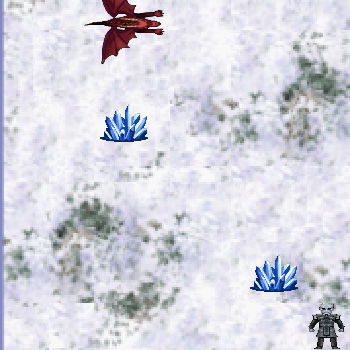

{'Seeker': 2, 'Hider': 3}



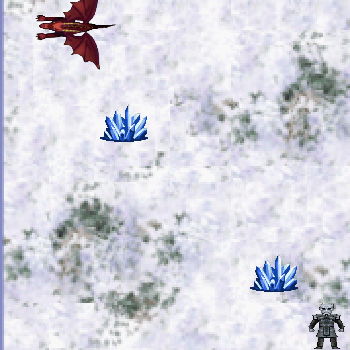

{'Seeker': 0, 'Hider': 2}



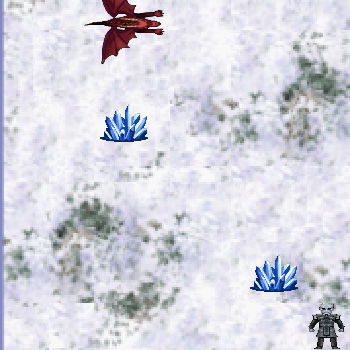

{'Seeker': 2, 'Hider': 3}



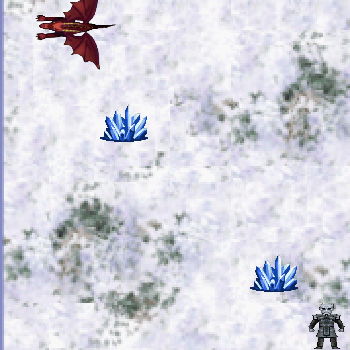

{'Seeker': 2, 'Hider': 2}



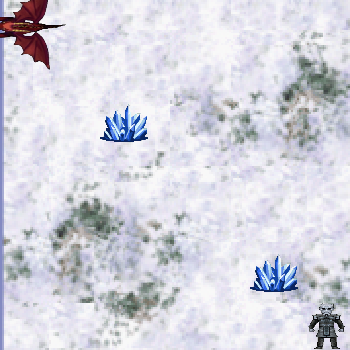

{'Seeker': 0, 'Hider': 3}



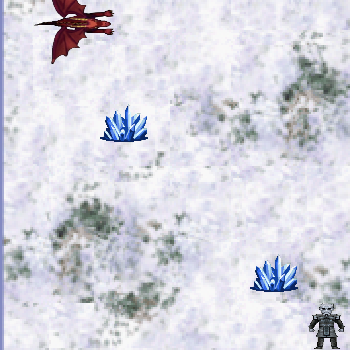

{'Seeker': 2, 'Hider': 3}



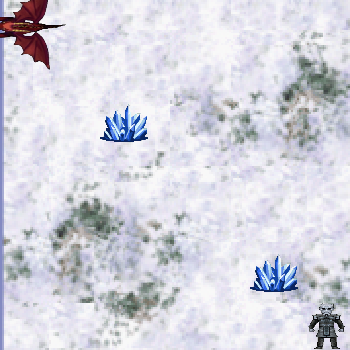

{'Seeker': 0, 'Hider': 2}



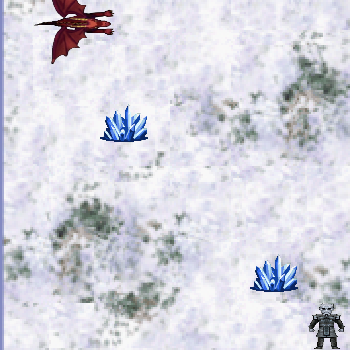

{'Seeker': 0, 'Hider': 3}



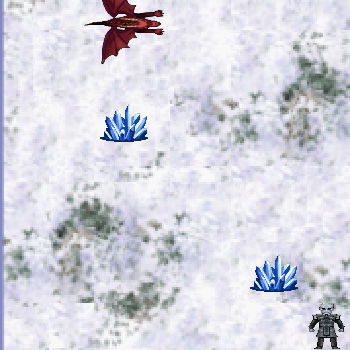

{'Seeker': 1, 'Hider': 2}



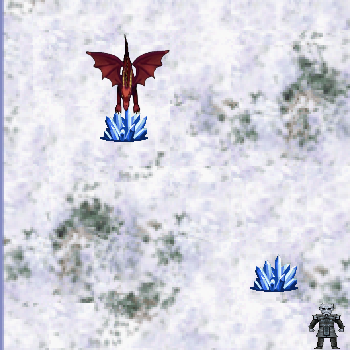

{'Seeker': 2, 'Hider': 3}



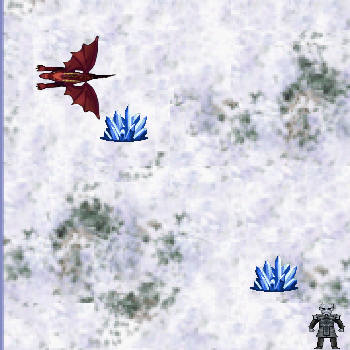

In [6]:
env = HideAndSeek(size = 7,sight_len = 0,n_obstacles = 3, static = True)
obs = env.reset()


env.render_rgb()
env.actions = {"Seeker":0, "Hider":0}
d = 1
for i in range(20):
   # Here we would start to select actions and start to learn
   env.select_random_actions()
   print(env.actions)
   obs, rewards, terminations,truncations,info = env.step(env.actions)
   env.render_rgb(mode='human')

   #env.render(d)
   if truncations["Seeker"]:
     print('Too many steps, game over')
   if terminations["Hider"]:
     print("The Seeker Won!")
     break

### Rendering: Dynamic case
Both the agents are moving. Line of sight implemented. Hider is caught when enters the Seekers' line of sight.

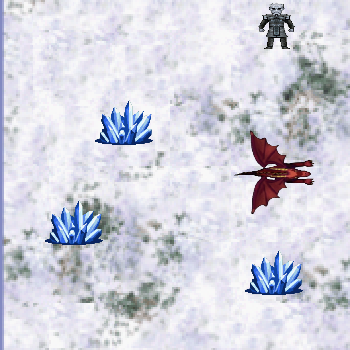

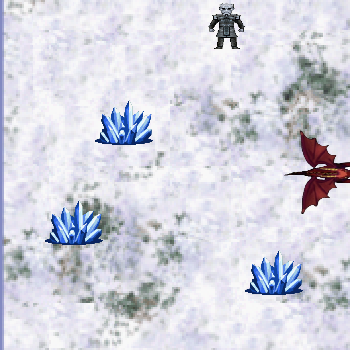

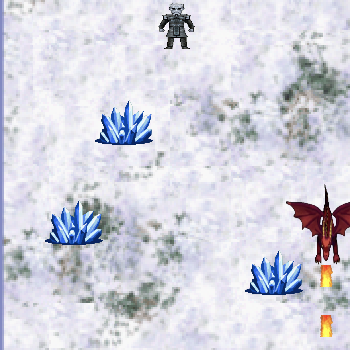

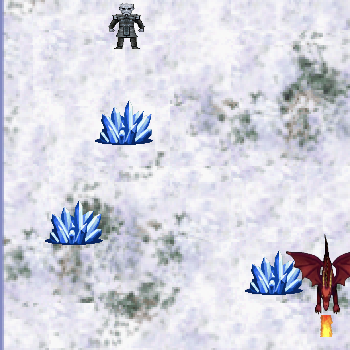

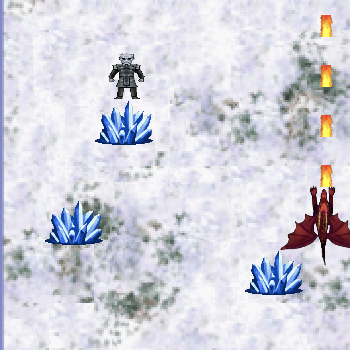

...

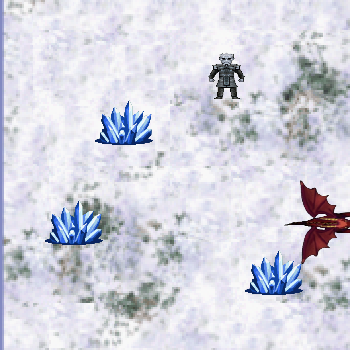

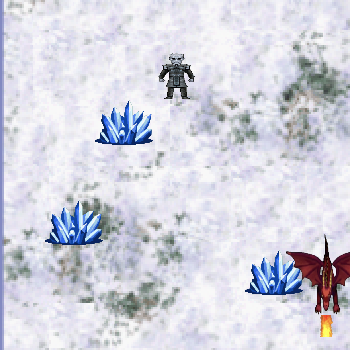

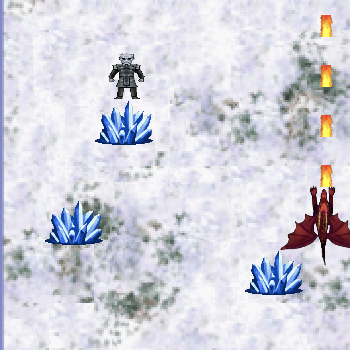

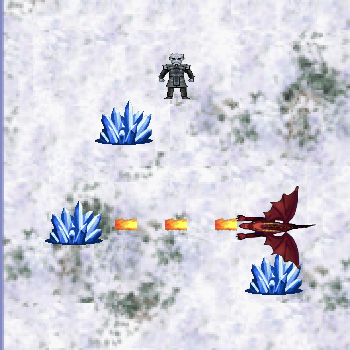

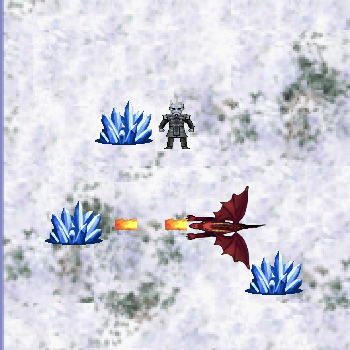

In [ ]:
env = HideAndSeek(size = 7,sight_len = 4,n_obstacles = 3)
obs = env.reset()


env.render_rgb()
env.actions = {"Seeker":0, "Hider":0}
d = 1
for i in range(20):
   # Here we would start to select actions and start to learn
   env.select_random_actions()
   obs, rewards, terminations,truncations,info = env.step(env.actions)
   env.render_rgb()
   
   if truncations["Seeker"]:
     print('Too many steps, game over')
   if terminations["Hider"]:
     print("The Seeker Won!")
     break

## AGENT IMPLEMENTATION

### Static case - Training and Rendering

Hider is fixed in the bottom right corner. The seeker is a trained agent --> like finding the optimal path

Number of episodes for training: 10000
SEEKER: ExpectedSarsa - HIDER: ExpectedSarsa 
Episode 1000/10000.
 The average number of steps is: 80.0
Episode 2000/10000.
 The average number of steps is: 80.0
Episode 3000/10000.
 The average number of steps is: 28.0
Episode 4000/10000.
 The average number of steps is: 16.0
Episode 5000/10000.
 The average number of steps is: 14.0
Episode 6000/10000.
 The average number of steps is: 14.0
Episode 7000/10000.
 The average number of steps is: 14.0
Episode 8000/10000.
 The average number of steps is: 14.0
Episode 9000/10000.
 The average number of steps is: 14.0
Episode 10000/10000.
 The average number of steps is: 14.0



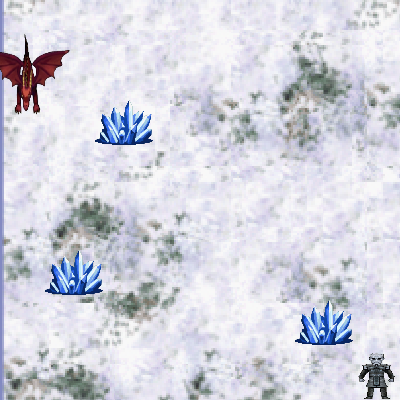

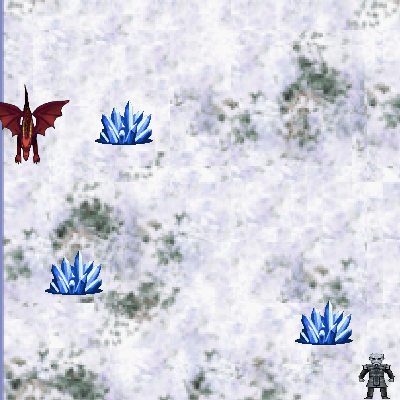

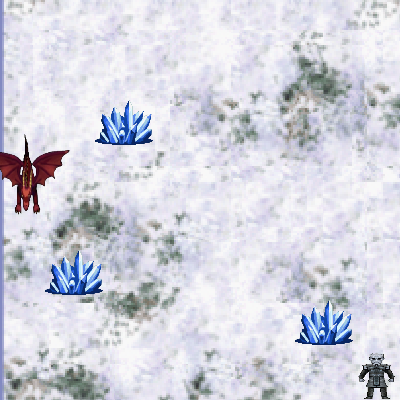

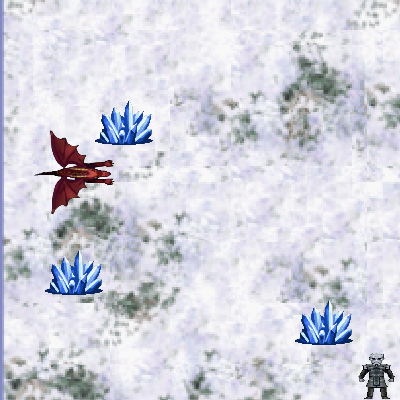

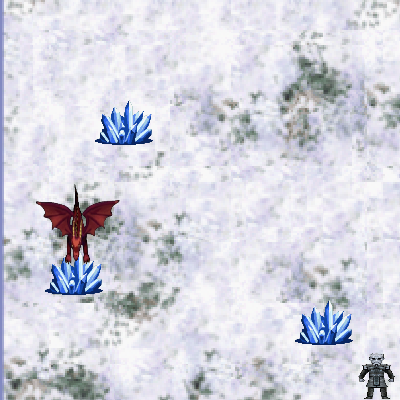

...

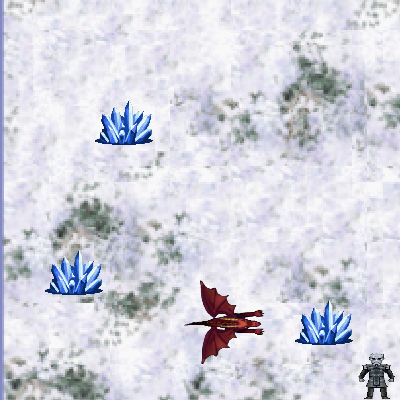

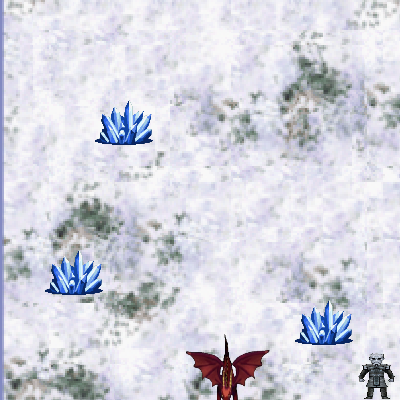

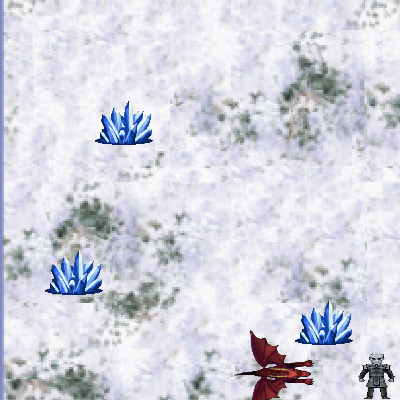

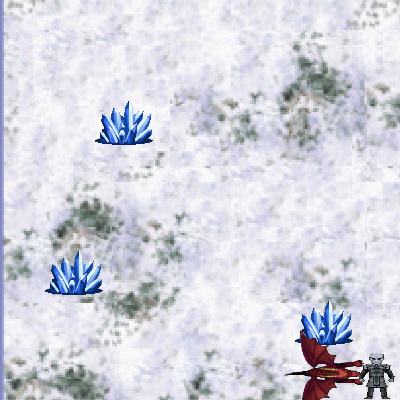

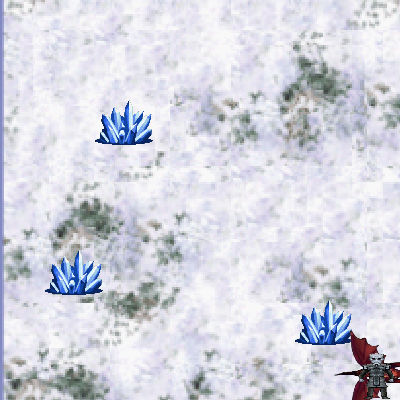

The hider has won 0 times, 
The seeker has won 100 times



In [ ]:
n_episodes_train = 10000
n_episodes_test = 100
env = HideAndSeek(size = 8,sight_len = 0,n_obstacles = 3, static = True)
start_epsilon = 1

epsilon_decay = start_epsilon/(n_episodes_train/2)

#env.actions = {"Seeker":0, "Hider":0}
print(f'Number of episodes for training: {n_episodes_train}')
# SEEKER: QLEARNING - HIDER: QLEARNING  
seeker1 = ExpectedSarsaAgent("Seeker",env.action_spaces['Seeker'].n,step_size = 0.1,initial_epsilon = start_epsilon,epsilon_decay = epsilon_decay,final_epsilon = 0.0,discount_factor = 1)
hider1 = ExpectedSarsaAgent("Hider",env.action_spaces['Hider'].n,step_size = 0.1,initial_epsilon = start_epsilon,epsilon_decay = epsilon_decay,final_epsilon = 0.0,discount_factor = 1)

print('SEEKER: ExpectedSarsa - HIDER: ExpectedSarsa ')
lengths = game_test(env,seeker1,hider1,n_episodes_train, n_episodes_test)

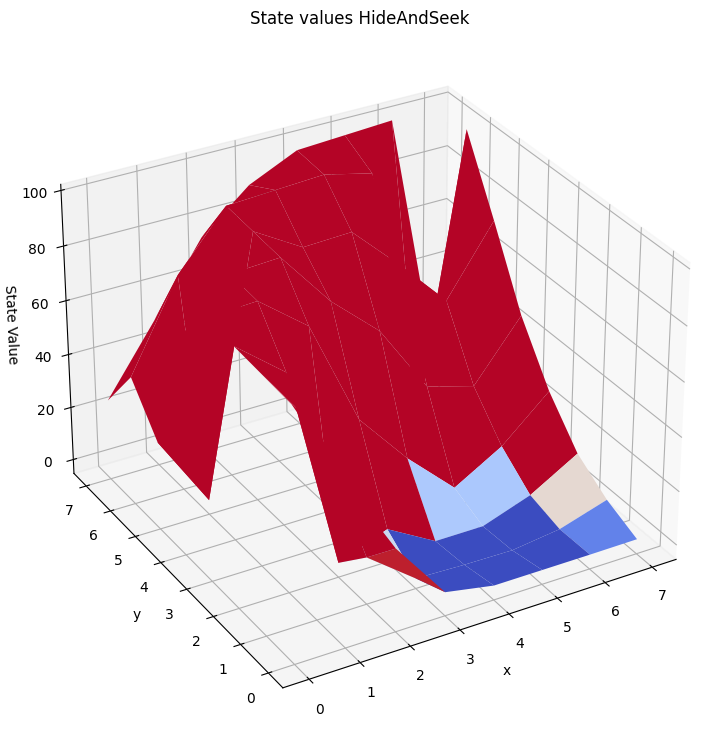

In [ ]:
#PLOTTING STATE VALUE FUNCTION
d = defaultdict(int)
for key, value in seeker1.q_values.items():
    new_key = (key[0], key[1])
    d[new_key] = np.max(seeker1.q_values[key])
    #seeker1.q_values[key] = np.max(seeker1.q_values[key])
plot_state_values(d)

### Dynamic case
Both Hider and Seeker are trained agents. 

#### Experimentation on different types of agents

Number of episodes for training: 10000
SEEKER: QLEARNING - HIDER: QLEARNING 
Episode 1000/10000.
 The average number of steps is: 20.966966966966968
Episode 2000/10000.
 The average number of steps is: 19.322
Episode 3000/10000.
 The average number of steps is: 16.878
Episode 4000/10000.
 The average number of steps is: 20.567
Episode 5000/10000.
 The average number of steps is: 37.87
Episode 6000/10000.
 The average number of steps is: 52.808
Episode 7000/10000.
 The average number of steps is: 48.235
Episode 8000/10000.
 The average number of steps is: 49.027
Episode 9000/10000.
 The average number of steps is: 49.536
Episode 10000/10000.
 The average number of steps is: 48.491



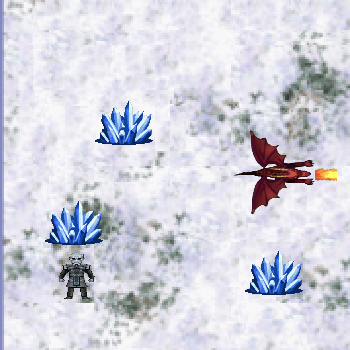

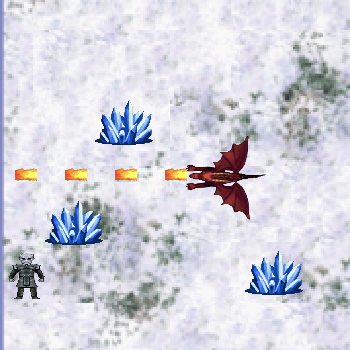

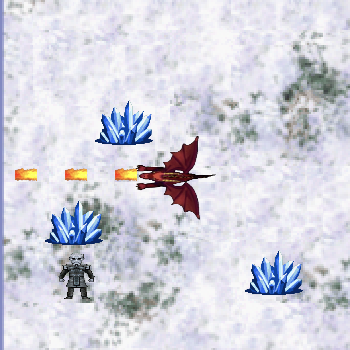

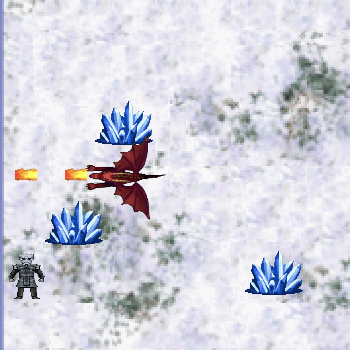

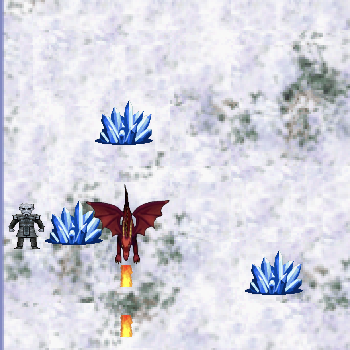

...

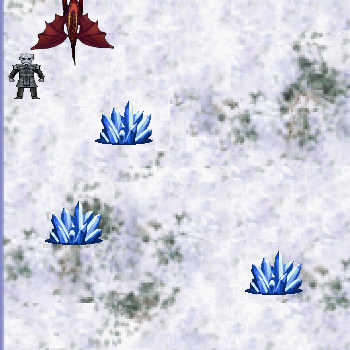

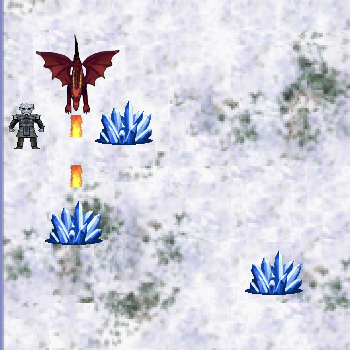

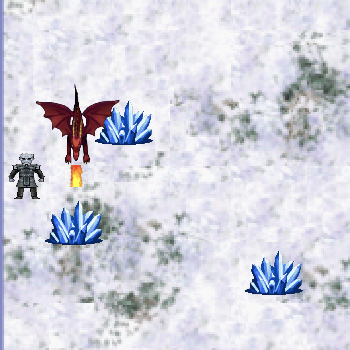

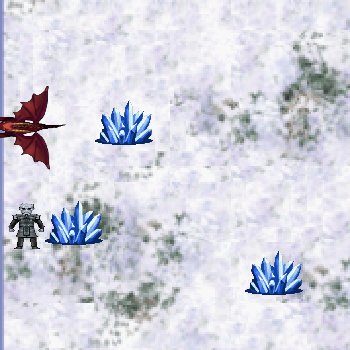

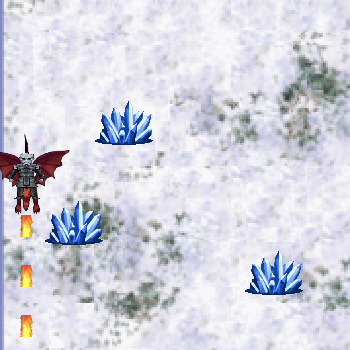

The hider has won 501 times, 
The seeker has won 499 times

SEEKER: ESARSA - HIDER: QLEARNING 
Episode 1000/10000.
 The average number of steps is: 21.56856856856857
Episode 2000/10000.
 The average number of steps is: 18.376
Episode 3000/10000.
 The average number of steps is: 15.701
Episode 4000/10000.
 The average number of steps is: 18.221
Episode 5000/10000.
 The average number of steps is: 32.327
Episode 6000/10000.
 The average number of steps is: 52.831
Episode 7000/10000.
 The average number of steps is: 50.933
Episode 8000/10000.
 The average number of steps is: 52.386
Episode 9000/10000.
 The average number of steps is: 51.84
Episode 10000/10000.
 The average number of steps is: 50.606



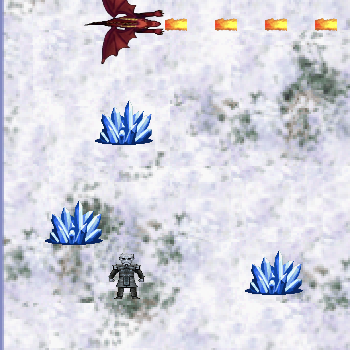

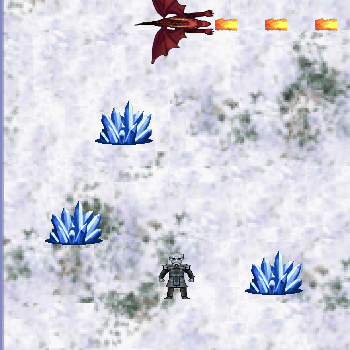

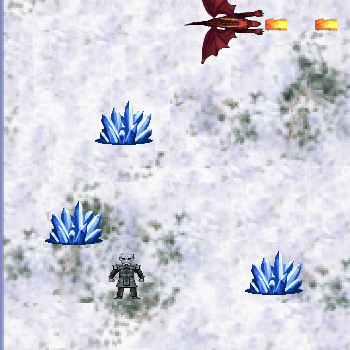

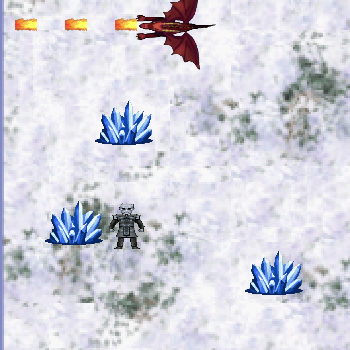

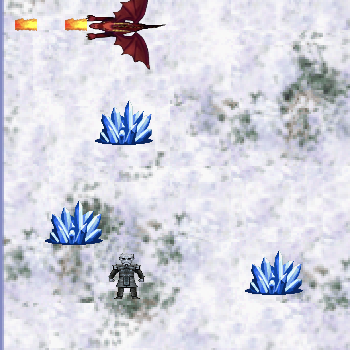

...

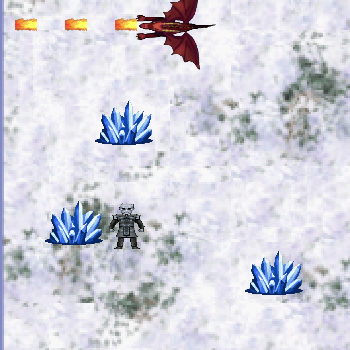

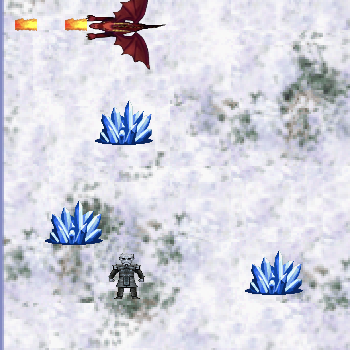

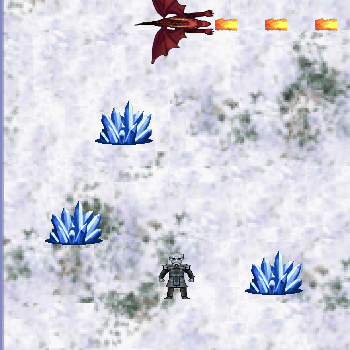

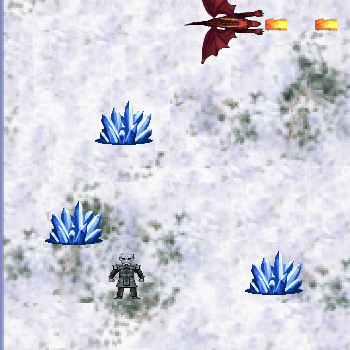

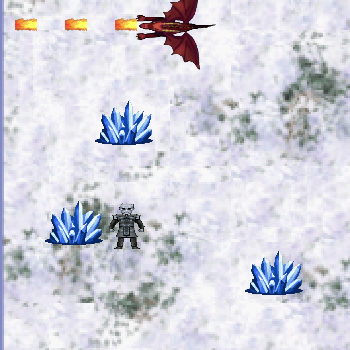

The hider has won 513 times, 
The seeker has won 487 times

SEEKER: QLEARNING - HIDER: ESARSA
Episode 1000/10000.
 The average number of steps is: 21.72172172172172
Episode 2000/10000.
 The average number of steps is: 19.384
Episode 3000/10000.
 The average number of steps is: 19.545
Episode 4000/10000.
 The average number of steps is: 24.345
Episode 5000/10000.
 The average number of steps is: 39.524
Episode 6000/10000.
 The average number of steps is: 52.032
Episode 7000/10000.
 The average number of steps is: 49.537
Episode 8000/10000.
 The average number of steps is: 51.769
Episode 9000/10000.
 The average number of steps is: 51.16
Episode 10000/10000.
 The average number of steps is: 50.814



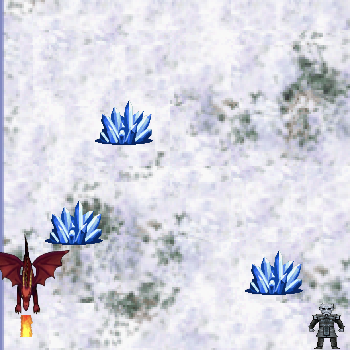

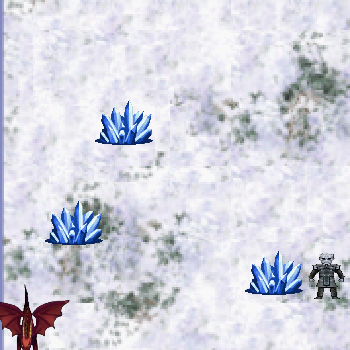

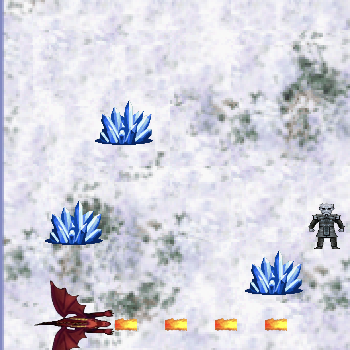

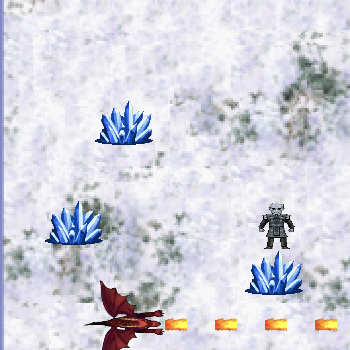

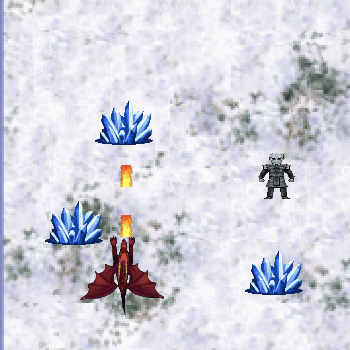

...

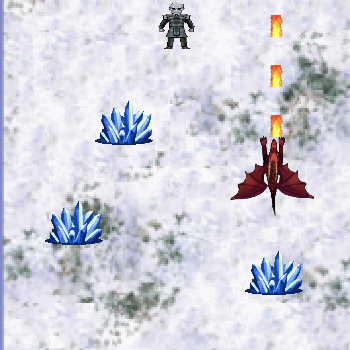

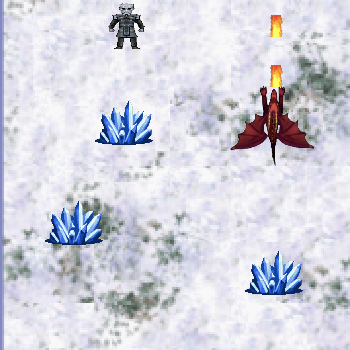

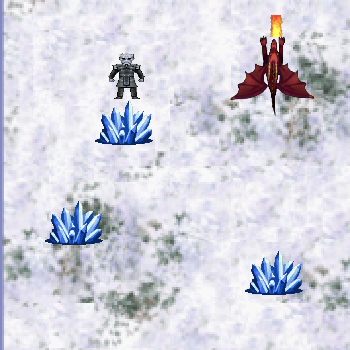

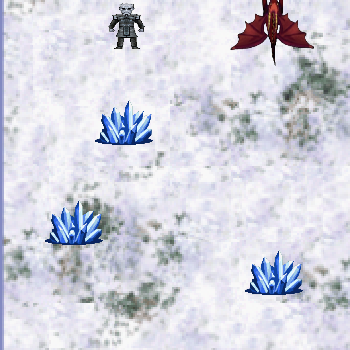

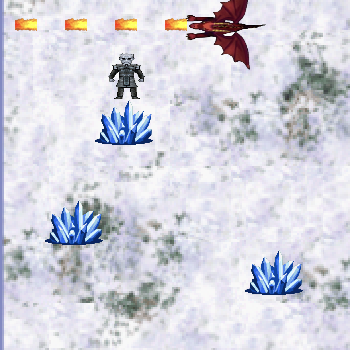

The hider has won 506 times, 
The seeker has won 494 times

SEEKER: ESARSA - HIDER: ESARSA
Episode 1000/10000.
 The average number of steps is: 21.15915915915916
Episode 2000/10000.
 The average number of steps is: 19.767
Episode 3000/10000.
 The average number of steps is: 19.467
Episode 4000/10000.
 The average number of steps is: 22.425
Episode 5000/10000.
 The average number of steps is: 38.009
Episode 6000/10000.
 The average number of steps is: 51.921
Episode 7000/10000.
 The average number of steps is: 41.8
Episode 8000/10000.
 The average number of steps is: 23.713
Episode 9000/10000.
 The average number of steps is: 21.641
Episode 10000/10000.
 The average number of steps is: 21.481



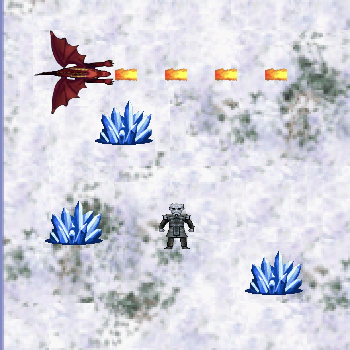

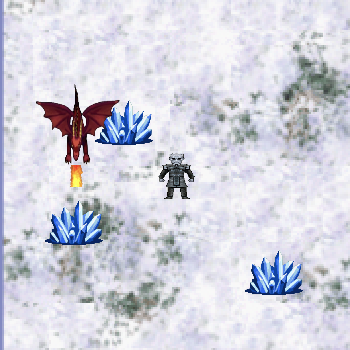

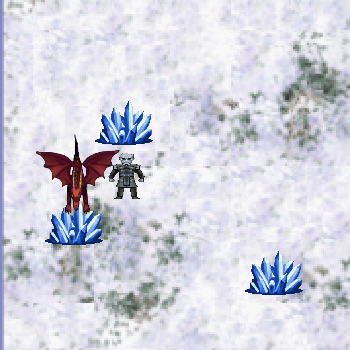

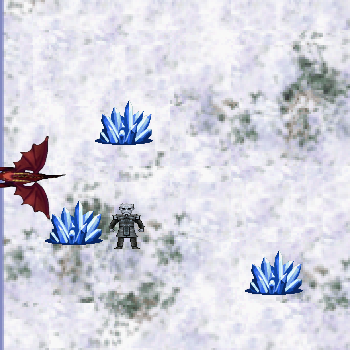

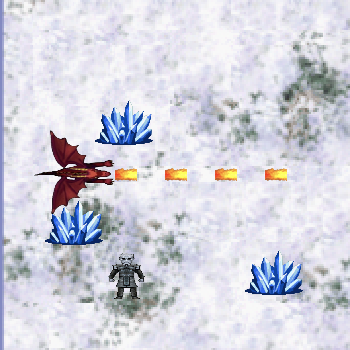

...

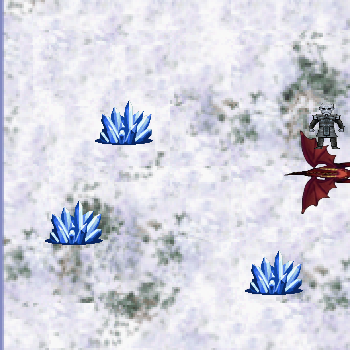

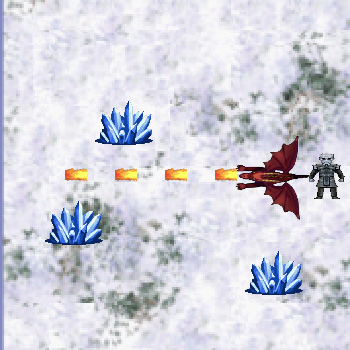

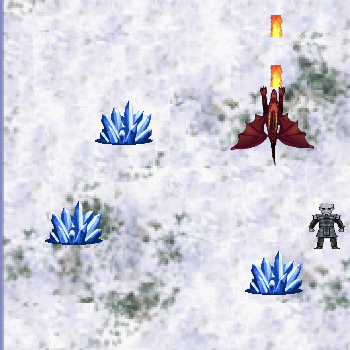

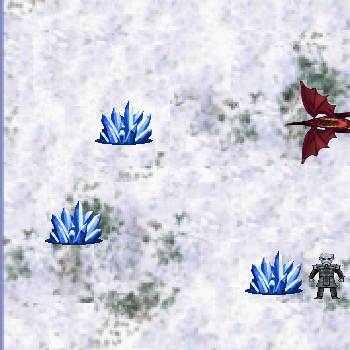

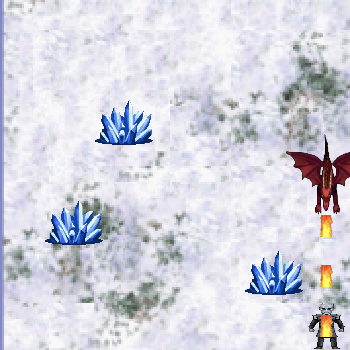

The hider has won 11 times, 
The seeker has won 989 times



In [ ]:
n_episodes_train = 10000
n_episodes_test = 1000

env = HideAndSeek(size = 7,sight_len = 4,n_obstacles = 3)

start_epsilon = 1
epsilon_decay = start_epsilon/(n_episodes_train/2)

#env.actions = {"Seeker":0, "Hider":0}
print(f'Number of episodes for training: {n_episodes_train}')
# SEEKER: QLEARNING - HIDER: QLEARNING  
seeker1 = QLearningAgent("Seeker",env.action_spaces['Seeker'].n,step_size = 0.1,initial_epsilon = start_epsilon,epsilon_decay = epsilon_decay,final_epsilon = 0.0,discount_factor = 1)
hider1 = QLearningAgent("Hider",env.action_spaces['Hider'].n,step_size = 0.1,initial_epsilon = start_epsilon,epsilon_decay = epsilon_decay,final_epsilon = 0.0,discount_factor = 1)

print('SEEKER: QLEARNING - HIDER: QLEARNING ')
game_test(env,seeker1,hider1,n_episodes_train, n_episodes_test)

# SEEKER: ESARSA - HIDER: QLEARNING  
seeker2 = ExpectedSarsaAgent("Seeker",env.action_spaces['Seeker'].n,step_size = 0.1,initial_epsilon = start_epsilon,epsilon_decay = epsilon_decay,final_epsilon = 0.0,discount_factor = 1)
hider2 = QLearningAgent("Hider",env.action_spaces['Hider'].n,step_size = 0.1,initial_epsilon = start_epsilon,epsilon_decay = epsilon_decay,final_epsilon = 0.0,discount_factor = 1)
print('SEEKER: ESARSA - HIDER: QLEARNING ')
game_test(env,seeker2,hider2,n_episodes_train, n_episodes_test)

# SEEKER: QLEARNING - HIDER: ESARSA
seeker3 = QLearningAgent("Seeker",env.action_spaces['Seeker'].n,step_size = 0.1,initial_epsilon = start_epsilon,epsilon_decay = epsilon_decay,final_epsilon = 0.0,discount_factor = 1)
hider3 = ExpectedSarsaAgent("Hider",env.action_spaces['Hider'].n,step_size = 0.1,initial_epsilon = start_epsilon,epsilon_decay = epsilon_decay,final_epsilon = 0.0,discount_factor = 1)
print('SEEKER: QLEARNING - HIDER: ESARSA')
game_test(env,seeker3,hider3,n_episodes_train, n_episodes_test)

# SEEKER: ESARSA - HIDER: ESARSA
seeker4 = ExpectedSarsaAgent("Seeker",env.action_spaces['Seeker'].n,step_size = 0.1,initial_epsilon = start_epsilon,epsilon_decay = epsilon_decay,final_epsilon = 0.0,discount_factor = 1)
hider4 = ExpectedSarsaAgent("Hider",env.action_spaces['Hider'].n,step_size = 0.1,initial_epsilon = start_epsilon,epsilon_decay = epsilon_decay,final_epsilon = 0.0,discount_factor = 1)
print('SEEKER: ESARSA - HIDER: ESARSA')
game_test(env,seeker4,hider4,n_episodes_train,n_episodes_test)

In [ ]:
#TRACKING THE PERFORMANCE OF EACH PAIR OF AGENTS

#1 SEEKER: QLEARNING - HIDER: QLEARNING  
print('Seeker: Q-learning, training Hider: Q-learning.\nHider: Q-learning, training Seeker: Q-learning.\nNumber of hiders victories: ',avg_victories(env,seeker1,hider1,1000,10),'\n')

#Test agents with agents of a different type they where trained with 
print('Seeker: Q-learning, training Hider: Q-learning.\nHider: Sarsa, training Seeker: Q-learning.\nNumber of hiders victories: ',avg_victories(env,seeker1,hider3,1000,10),'\n')
print('Seeker: Sarsa, training Hider: Q-learning.\nHider: Q-learning, training Seeker: Q-learning.\nNumber of hiders victories: ',avg_victories(env,seeker2,hider1,1000,10),'\n')

#2 SEEKER: ESARSA - HIDER: QLEARNING 
print('Seeker:Sarsa, training Hider: Q-learning.\nHider: Q-learning, training Seeker: Sarsa.\nNumber of hiders victories: ',avg_victories(env,seeker2,hider2,1000,10),'\n')

#3 SEEKER: QLEARNING - HIDER: ESARSA 
print('Seeker:Q-learning, training Hider: Sarsa.\nHider: Sarsa, training Seeker: Q-learning.\nNumber of hiders victories: ',avg_victories(env,seeker3,hider3,1000,10),'\n')

#4 SEEKER: ESARSA - HIDER: ESARSA 
print('Seeker:Sarsa, training Hider: Sarsa.\nHider: Sarsa, training Seeker: Sarsa.\nNumber of hiders victories: ',avg_victories(env,seeker4,hider4,1000,10),'\n')

Seeker: Q-learning, training Hider: Q-learning.
Hider: Q-learning, training Seeker: Q-learning.
Number of hiders victories:  511.2 

Seeker: Q-learning, training Hider: Q-learning.
Hider: Sarsa, training Seeker: Q-learning.
Number of hiders victories:  710.8 

Seeker: Sarsa, training Hider: Q-learning.
Hider: Q-learning, training Seeker: Q-learning.
Number of hiders victories:  570.6 

Seeker:Sarsa, training Hider: Q-learning.
Hider: Q-learning, training Seeker: Sarsa.
Number of hiders victories:  514.5 

Seeker:Q-learning, training Hider: Sarsa.
Hider: Sarsa, training Seeker: Q-learning.
Number of hiders victories:  509.3 

Seeker:Sarsa, training Hider: Sarsa.
Hider: Sarsa, training Seeker: Sarsa.
Number of hiders victories:  6 



#### Experimentation on Episodic Semi Gradient Sarsa (implemented later therefore not above)

Number of episodes for training: 10000
SEEKER: EpisodicSARSA - HIDER: EpisodicSARSA
Episode 1000/10000.
 The average number of steps is: 21.32732732732733
Episode 2000/10000.
 The average number of steps is: 21.268
Episode 3000/10000.
 The average number of steps is: 23.522
Episode 4000/10000.
 The average number of steps is: 31.962
Episode 5000/10000.
 The average number of steps is: 50.063
Episode 6000/10000.
 The average number of steps is: 66.901
Episode 7000/10000.
 The average number of steps is: 70.078
Episode 8000/10000.
 The average number of steps is: 70.212
Episode 9000/10000.
 The average number of steps is: 67.066
Episode 10000/10000.
 The average number of steps is: 65.98



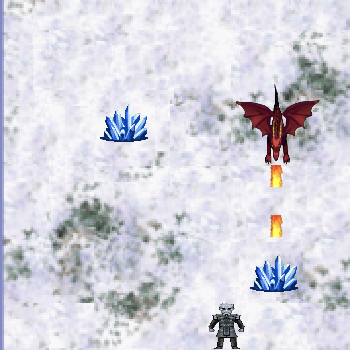

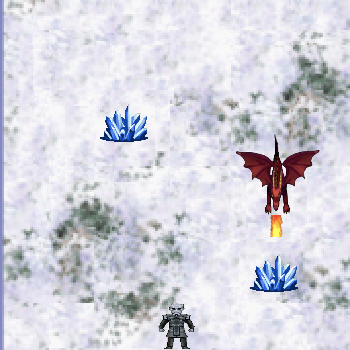

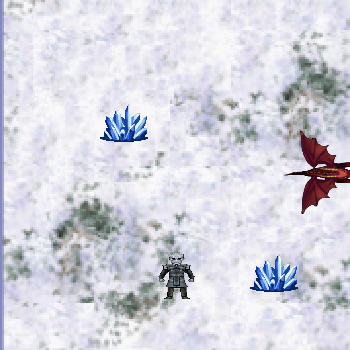

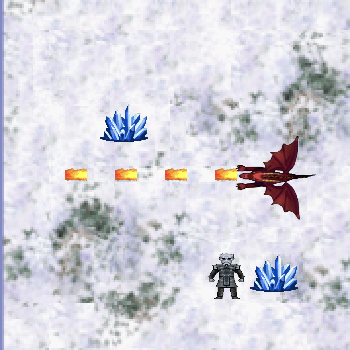

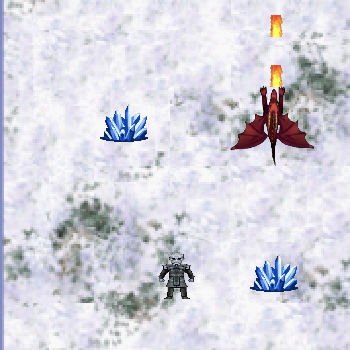

...

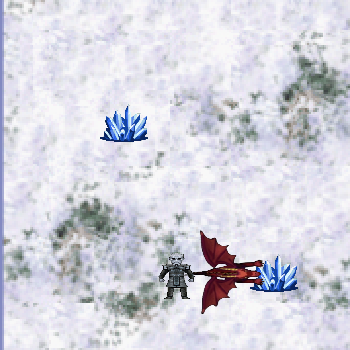

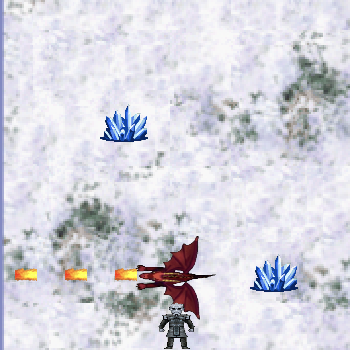

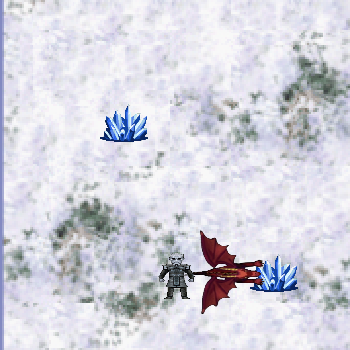

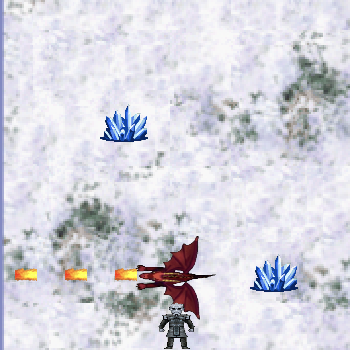

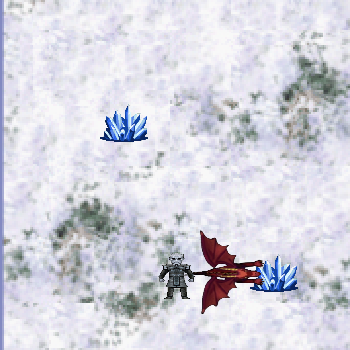

The hider has won 838 times, 
The seeker has won 162 times



In [6]:
n_episodes_train = 10000
n_episodes_test = 1000

env = HideAndSeek(size = 7,sight_len = 4,n_obstacles = 3)

start_epsilon = 1
epsilon_decay = start_epsilon/(n_episodes_train/2)

#env.actions = {"Seeker":0, "Hider":0}
print(f'Number of episodes for training: {n_episodes_train}')
# SEEKER: EpisodicSARSA - HIDER: EpisodicSARSA
seeker5 = EpisodicSemiGradientSarsaAgent("Seeker",env.action_spaces['Seeker'].n,step_size = 0.1,initial_epsilon = start_epsilon,epsilon_decay = epsilon_decay,final_epsilon = 0.0,discount_factor = 1)
seeker5.agent_init()
hider5 = EpisodicSemiGradientSarsaAgent("Hider",env.action_spaces['Hider'].n,step_size = 0.1,initial_epsilon = start_epsilon,epsilon_decay = epsilon_decay,final_epsilon = 0.0,discount_factor = 1)
hider5.agent_init()
print('SEEKER: EpisodicSARSA - HIDER: EpisodicSARSA')
game_test_episodic(env,seeker5,hider5,n_episodes_train, n_episodes_test)

In [9]:
#4 SEEKER: ESARSA - HIDER: ESARSA 
print('Seeker:Episodic Sarsa, training Hider: Episodic Sarsa.\nHider: Episodic Sarsa, training Seeker: Episodic Sarsa.\nNumber of hiders victories: ',avg_victories_episodic(env,seeker5,hider5,1000,10),'\n')

Seeker:Episodic Sarsa, training Hider: Episodic Sarsa.
Hider: Episodic Sarsa, training Seeker: Episodic Sarsa.
Number of hiders victories:  959.1 



#### Performance evaluation

##### Distance test

In [ ]:
from math import sqrt
#euclidean distance
def distance_agents(envir):
  return sqrt((envir.seeker_location[0]-envir.hider_location[0])**2 +(envir.seeker_location[1]-envir.hider_location[1])**2)

In [ ]:
#game with trained q-learning agents
obs = env.reset()
n_steps = 0
distances = []

while True: 
  av_actions = env.f_available_actions()

  action_seeker = seeker1.policy(obs,av_actions['Seeker'])
  action_hider = hider1.policy(obs,av_actions['Hider'])
  env.actions = {'Seeker':action_seeker,'Hider':action_hider}

  new_obs, rewards, terminations,truncations,info = env.step(env.actions)
  obs = new_obs

  n_steps+=1
  
  #Appending the distance between the agents at every step
  distances.append(distance_agents(env))

  if truncations["Seeker"]:
      break

  if terminations["Hider"]:
      break

In [ ]:
#game with random agents
obs = env.reset()

n_steps_random = 0
distances_random = []

while True:
   env.select_random_actions()
   obs, rewards, terminations,truncations,info = env.step(env.actions)
   
   n_steps_random+=1
   
   #Appending the distance between the agents at every step
   distances_random.append(distance_agents(env))

   if truncations["Seeker"]:
     break

   if terminations["Hider"]:
     break

In [ ]:
#Checking that the two games were of comparable lenght
print(len(distances))
print(len(distances_random))

24
24


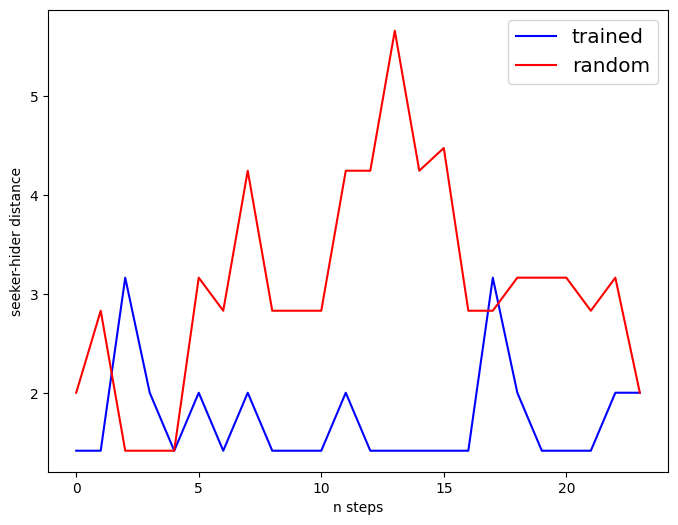

In [ ]:
from matplotlib import pyplot as plt

#plotting the distances

x1 = range(len(distances))
x2 = range(len(distances_random))


fig, ax = plt.subplots(figsize=(8,6))
ax.plot(x1, distances, color='blue', label = 'trained')
ax.plot(x2, distances_random, color = 'red', label='random')

plt.xlabel('n steps')
plt.ylabel('seeker-hider distance')
legend = ax.legend(loc='upper right', fontsize='x-large')

plt.show()

##### Cornering test

In [ ]:
#Training q-learning agents

n_episodes_train = 10000
env = HideAndSeek(size = 7,sight_len = 4,n_obstacles = 3)

start_epsilon = 1
epsilon_decay = start_epsilon/(n_episodes_train/2)

# SEEKER: QLEARNING - HIDER: QLEARNING  
seeker1 = QLearningAgent("Seeker",env.action_spaces['Seeker'].n,step_size = 0.1,initial_epsilon = start_epsilon,epsilon_decay = epsilon_decay,final_epsilon = 0.0,discount_factor = 1)
hider1 = QLearningAgent("Hider",env.action_spaces['Hider'].n,step_size = 0.1,initial_epsilon = start_epsilon,epsilon_decay = epsilon_decay,final_epsilon = 0.0,discount_factor = 1)

game_train(env,seeker1,hider1, n_episodes_train,verbose=False)

In [ ]:
#Want to determine the cornering behavior by seeing the location of the hider the moment it is caught by the seeker
#To do so we record the cell in which the seeker catches the hider the most. 

#Use a dictionary of the format {(x,y):n_victories}

winning_cell = defaultdict(int)


for ep in range(1,1000+1):
    obs = env.reset()

    while True: 
      av_actions = env.f_available_actions()

      action_seeker = seeker1.policy(obs,av_actions['Seeker'])
      action_hider = hider1.policy(obs,av_actions['Hider'])
      env.actions = {'Seeker':action_seeker,'Hider':action_hider}
      new_obs, rewards, terminations,truncations,info = env.step(env.actions)
      obs = new_obs

      if truncations["Seeker"]:
          break

      if terminations["Hider"]:
          winning_cell[tuple(env.hider_location)]+=1
          break

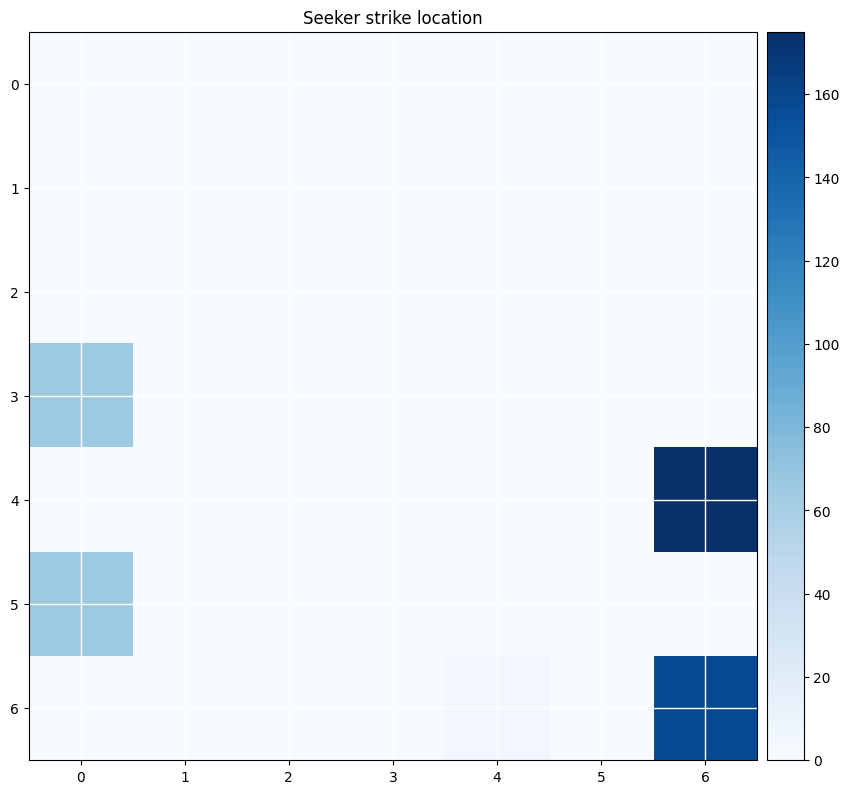

In [ ]:
plot_policy(winning_cell)